In [186]:
import itertools
from datetime import datetime

import numpy as np
import scipy as sp
import scipy.stats
import scipy.special
import scipy.integrate
import statsmodels as sm
from statsmodels.distributions.empirical_distribution import ECDF
import plotly
import plotly.graph_objs as go

from numba import njit

np.random.seed(datetime.now().microsecond)
np.set_printoptions(
    precision=5,
    linewidth=120,
)
plotly.offline.init_notebook_mode()

# Задание №1. Вероятностные распределения

## Выбор распределений

* Дискретное: [*гипергеометрическое*](https://ru.wikipedia.org/wiki/Гипергеометрическое_распределение)
* Непрерывное: [*нормальное*](https://ru.wikipedia.org/wiki/Нормальное_распределение)

## Описание основных характеристик распределений 

### Гипергеометрическое распределение

Гипергеометрическое распределение - дискретное распределение,
описывающее вероятность события, при котором ровно $k$ из $n$ случайно
выбранных элементов окажутся *помеченными*, при этом выборка
осуществляется из множества мощности $N$, в котором присутствует $m$
помеченных элементов. Считается, что каждый из элементов может быть
выбран с одинаковой вероятностью $\frac{1}{N}$. Запишем это формально:
$$\begin{gathered}
    N \in \mathbb{N},\ m \in \overline{0, N},\ n \in \overline{0, N},\\
    k \in \overline{\max(0, m + n - N), \min(m, n)}
\end{gathered}$$

Тогда $HG(N, m, n)$ описывает вероятность события, при котором ровно $k$
из $n$ элементов выборки окажутся *помеченными*:
$$\left\{\ \xi \sim HG(N, m, n)\ \right\}
\iff
\left\{\mathbb{P}\left(\, \xi=k \,\right) = \frac{\binom{m}{k}\binom{N-m}{n-k}}{\binom{N}{n}}\right\}$$

#### Математическое ожидание

По определению, математическое ожидание случайной величины – это ее
$1^\text{й}$ начальный момент. Для начала, найдем $k^\text{й}$ начальный
момент для $\xi$ (это понадобится для дальнейших выводов):
$$\mathbb{E}\left[\, \xi^r \,\right]
= \sum_{k=0}^{n} k^r \cdot \mathbb{P}\left(\, \xi=k \,\right)
= \sum_{k=0}^{n} k^r\frac{\binom{m}{k}\binom{N-m}{n-k}}{\binom{N}{n}}$$
Можем считать, что сумма берется при
$k=\overline{1,n}$, так как слагаемое при $k=0$ будет равно $0$.
Заметим, что $$\begin{aligned}
    k\binom{m}{k} &= k \frac{m!}{k!(m-k)!} =\\
                &= k \frac{m \cdot (m-1)!}{k \cdot (k-1)! \cdot (m-k)!} =\\
                &= m \frac{(m-1)!}{(k-1)! \cdot \left(m-1 - (k-1)\right)!} =\\
                &= m \binom{m-1}{k-1}
\end{aligned}$$ и, как следствие, $$\binom{N}{n}
= \frac{1}{n} \cdot n \cdot \binom{N}{n}
= \frac{1}{n} N \binom{N-1}{n-1}$$
Подставим:
$$\mathbb{E}\left[\, \xi^r \,\right] = \frac{n \cdot m}{N}
\sum_{k=1}^{r-1} \frac{\binom{m-1}{k-1}\binom{N-m}{n-k}}{\binom{N-1}{n-1}}$$
Положим $j := k-1$ и изменим индекс суммирования на
$j = \overline{0, n-1}$. Заметим, что $n - k = n - (j+1) = (n-1) - j$ и
$N - m = (N-1) - (m-1)$:
$$\mathbb{E}\left[\, \xi^r \,\right] = \frac{n \cdot m}{N} \color{dodgerblue}{\sum_{j=0}^{n-1} (j+1)^{r-1}
\frac{\binom{m-1}{j}\binom{(N-1) - (m-1)}{(n-1) - j}}{\binom{N-1}{n-1}}}$$
Заметим, что выделенная часть выражения может быть записана, как
$\mathbb{E}\left[\, (\theta+1)^{r-1} \,\right]$, где
$\theta \sim HG(N-1, m-1, n-1)$. Следовательно,
$$\mathbb{E}\left[\, \xi^r \,\right] = \frac{n \cdot m}{N} \mathbb{E}\left[\, (\theta+1)^{r-1} \,\right]$$
Таким образом, $$\boxed{
    \mathbb{E}\left[\, \xi \,\right] = \frac{n \cdot m}{N}
}$$

#### Дисперсия

По определению дисперсии,
$$\mathrm{Var}\left[\, \xi \,\right] = \mathbb{E}\left[\, \left(\ \xi - \mathbb{E}\left[\, \xi \,\right]\ \right)^2 \,\right] = \mathbb{E}\left[\, \xi^2 \,\right] - \left(\ \mathbb{E}\left[\, \xi \,\right]\ \right)^2$$
Выведем $2^\text{й}$ начальный момент:
$$\mathbb{E}\left[\, \xi^2 \,\right]
= \frac{n \cdot m}{N}\mathbb{E}\left[\, \theta+1 \,\right]
= \frac{n \cdot m}{N}\left(\frac{(n-1)(m-1)}{N-1}+1\right)$$
Подставим:
$$\begin{aligned}
    \mathrm{Var}\left[\, \xi \,\right] &= \mathbb{E}\left[\, \xi^2 \,\right] - \left(\mathbb{E}\left[\, \xi \,\right]\right)^2 =\\
              &= \frac{n \cdot m}{N}\left(\frac{(n-1)(m-1)}{N-1}+1\right) - \left(\frac{n \cdot m}{N}\right)^2=\\
              &= \frac{n \cdot m}{N}\left(\frac{(n-1)(m-1)}{N-1} + 1 - \frac{n \cdot m}{N}\right)
\end{aligned}$$
Таким образом, $$\boxed{
    \mathrm{Var}\left[\, \xi \,\right] = \frac{n \cdot m}{N}\left(\frac{(n-1)(m-1)}{N-1} + 1 - \frac{n \cdot m}{N}\right)
}$$

#### Производящая функция

По определению, производящая функция вероятностей $G(z, \xi)$ – это
математическое ожидание новой случайной величины $z^\xi$. То есть:
$$G_\xi(z) = \mathbb{E}\left[\, z^\xi \,\right]$$
Для $\xi \sim HG(N, m, n)$ производящая функция выглядит так:
$$G_\xi(z) = \binom{N-m}{n}\left({}_{2}F_{1}(-m, -n; N-m-n+1; z) - 1\right)$$
Здесь ${}_{2}F_{1}$ - это [гипергеометрическая
функция](https://en.wikipedia.org/wiki/Hypergeometric_function),
определенная следующим образом:
$${}_{2}F_{1}(a,b;c;z) = \sum_{n=0}^{\infty} \frac{a^{(n)} b^{(n)}}{c^{(n)}} \frac{z^n}{n!}$$
, а $x^{(n)}$ - [возрастающий
факториал](https://en.wikipedia.org/wiki/Falling_and_rising_factorials),
определенный как: $$x^{(n)} = \prod_{k=0}^{n-1} (x + k)$$

#### Характеристическая функция

По определению, характеристическая функция случайно величины $\xi$
задается следующим образом:
$$\varphi_\xi (t) = \mathbb{E}\left[\, e^{it\xi} \,\right]$$ Для
$\xi \sim HG(N, m, n)$ характеристическая функция
[выглядит](https://ru.wikipedia.org/wiki/Гипергеометрическое_распределение)
так:
$$M_\xi(t) = \frac{\binom{N-D}{n}}{\binom{N}{n}}\ {}_{2}F_{1}\left(-n, -D; N-D-n+1; e^{it}\right)$$
Здесь ${}_{2}F_{1}$ - это гипергеометрическая функция.

#### Гистограмма вероятностей

Гистограмма – это графическое представление функции, приближающей
плотность вероятности распределения на основе выборки из него.

Чтобы построить гистограмму, сначала нужно разбить множество значений
выборки на несколько отрезков. Чаще всего, берут отрезки одинаковой
длины, чтобы облегчить восприятие получившегося результата, однако это
необязательно. Далее подсчитывается количество вхождений элементов
выборки в каждый из отрезков и рисуются прямоугольники, по площади
пропорциональные количеству попавших элементов выборки в соответствующий
отрезок.

Вообще говоря, гистограмму можно использовать не только для приближения
плотности на основе выборки, но и для визуализации самой плотности
распределения, зная его плотность.

Мы будем строить гистограмму вероятностей, писать будем на языке
[Python3](https://www.python.org) и использовать следующие библиотеки:

-   [NumPy](https://numpy.org) для работы с массивами
-   [SciPy](https://www.scipy.org) для комбинаторных и статистических
    функций
-   [Plotly](https://plot.ly/python/) для визуализации

Итак, для начала, определим класс гипергеометрического распределения
`HG`, который будет содержать в себе информацию о параметрах $N$, $m$ и
$n$ и предоставлять метод `p(k)`, возвращающий вероятность принятия
случайной величиной значения `k` при данных параметрах:

In [129]:
class HG(object):
    def __init__(self, N: int, m: int, n: int):
        self.N = N
        self.m = m
        self.n = n

    def p(self, k: int) -> float:
        return sp.special.comb(self.m, k) \
            * sp.special.comb(self.N-self.m, self.n-k) \
            / sp.special.comb(self.N, self.n)
    
    @property
    def expected(self):
        return self.n * self.m / self.N
    
    @property
    def variance(self):
        return self.expected * ((self.n - 1) * (self.m - 1) / (self.N - 1) + 1 - self.expected)
    
    @property
    def domain(self):
        return (max(0, self.m + self.n - self.N), min(self.m, self.n))

    def __str__(self) -> str:
        return f'HG({self.N}, {self.m}, {self.n})'

Далее создадим объект случайной величины $\xi \sim HG(30, 15, 20)$:

In [130]:
xi = HG(80, 15, 40)

Следующим шагом, определим интервал $\overline{0, n}$, на котором мы
будем рисовать нашу гистограмму:

In [131]:
hg_data_x = np.arange(*xi.domain)

И, наконец, построим гистограмму и выведем ее:

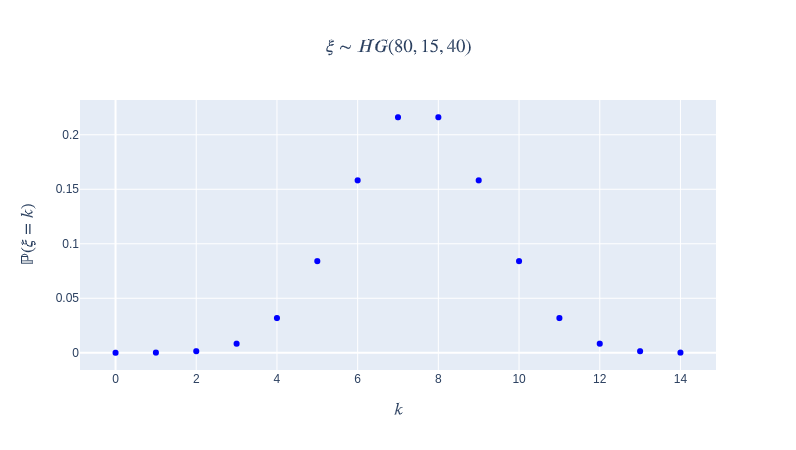

In [132]:
theoretical_hg_PDF = np.apply_along_axis(xi.p, 0, hg_data_x,)

theoretical_hg_PDF_trace=go.Scatter(
    name='PDF',
    legendgroup='PDF',
    x=hg_data_x,
    y=theoretical_hg_PDF,
    mode='markers',
    marker_color='blue',
)

hg_hist_fig = go.Figure(
    data=(theoretical_hg_PDF_trace,),
    layout=go.Layout(
        title=go.layout.Title(
            text=r'$\xi \sim ' + str(xi) + '$',
            x=.5,
        ),
        yaxis=go.layout.YAxis(
            title=go.layout.yaxis.Title(
                text=r'$\mathbb{P}(\xi=k)$',
            ),
        ),
        xaxis=go.layout.XAxis(
            title=go.layout.xaxis.Title(
                text=r'$k$',
            ),
        ),
    ),
)
plotly.offline.iplot(hg_hist_fig)

#### Функция распределения

По определению, функция распределения
$F_\xi(k) = \mathbb{P}\left(\, \xi < k \,\right)$. Для дискретной
случайной величины событие
$\{\xi < k\} = \bigcup\limits_{i=0}^{k-1}\{\xi=i\}$. Каждое из событий
$\{\xi=i\}\; \forall i \in \overline{0, k-1}$ являются попарно
несовместными. То есть $\forall i,j \in \overline{0, k-1}: i \neq j$
выполняется $\{\xi=i\}\cap\{\xi=j\}=\emptyset$. Из этого следует, что
$$\mathbb{P}\left(\, \xi < k \,\right) = \sum_{i=0}^{k-1}\mathbb{P}\left(\, \xi = i \,\right)$$
Подставим и получим: $$F_\xi(k)
= \sum_{i=0}^{k-1}\mathbb{P}\left(\, \xi = i \,\right)
= \sum_{i=0}^{k-1}\frac{\binom{m}{i}\binom{N-m}{n-i}}{\binom{N}{n}}$$

Построим график этой функции, учитывая, что аргументом $k$ должно быть
натуральное число, не превосходящее $n$:

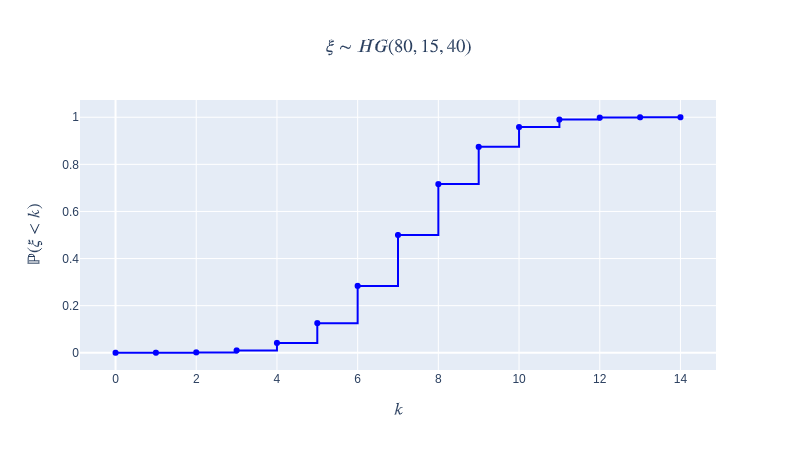

In [133]:
theoretical_hg_CDF = np.cumsum(np.apply_along_axis(xi.p, 0, hg_data_x))

theoretical_hg_CDF_trace=go.Scatter(
    name='CDF',
    legendgroup='CDF',
    x=hg_data_x,
    y=theoretical_hg_CDF,
    line=go.scatter.Line(
        shape='hv',
        color='blue',
    ),
)

hg_dist_fig = go.Figure(
    data=(theoretical_hg_CDF_trace,),
    layout=go.Layout(
        title=go.layout.Title(
            text=r'$\xi \sim ' + str(xi) + '$',
            x=.5,
        ),
        yaxis=go.layout.YAxis(
            title=go.layout.yaxis.Title(
                text=r'$\mathbb{P}(\xi<k)$',
            ),
        ),
        xaxis=go.layout.XAxis(
            title=go.layout.xaxis.Title(
                text=r'$k$',
            ),
        ),
    ),
)
hg_dist_fig.show()

### Нормальное распределение

Нормальное распределение - непрерывное распределение, описывающее
поведение величины отклонения измеряемого значения $x$ от истинного
значения $\mu$ (которое является математическим ожиданием) и в рамках
некоторого разброса $\sigma$ (среднеквадратичного отклонения). Запишем
это формально: $$\left\{ \eta \sim N(\mu, \sigma^2) \right\}
\iff
\left\{\begin{gathered}
    F_\eta(x) = \mathbb{P}\left(\, \eta < x \,\right) = \int_{-\infty}^{x} f_\eta(x)dx,\\
    \text{где } f_\eta(x) = \frac{1}{\sigma\sqrt{2\pi}}e^{-\frac{(x-\mu)^2}{2\sigma^2}} \text{– плотность вероятности}
\end{gathered}\right\}$$

#### Математическое ожидание

Найдем математическое ожидание $\eta \sim N(\mu, \sigma^2)$:
$$\begin{aligned}
    \mathbb{E}\left[\, \eta \,\right] &= \int_{-\infty}^{+\infty} x \cdot f_\eta(x)dx =\\
                  &= \int_{-\infty}^{+\infty} xe^{-\frac{(x-\mu)^2}{2\sigma^2}}dx =\\
                  &= \frac{1}{\sigma\sqrt{2\pi}} \int_{-\infty}^{+\infty} xe^{-\frac{(x-\mu)^2}{2\sigma^2}}dx
\end{aligned}$$
Сделаем замену $t = \frac{x-\mu}{\sqrt{2}\sigma}$:
$$\begin{aligned}
    \mathbb{E}\left[\, \eta \,\right] &= \frac{1}{\sigma\sqrt{2\pi}} \int_{-\infty}^{+\infty}(\sigma\sqrt{2}t + \mu) e^{-t^2} d\left(\frac{x-\mu}{\sqrt{2}\sigma}\right) =\\
                  &= \frac{\sigma\sqrt{2}}{\sqrt{\pi}}\int_{-\infty}^{+\infty}te^{-t^2}dt + \frac{\mu}{\sqrt{\pi}}\int_{-\infty}^{+\infty}e^{-t^2}dt =\\
                  &= \frac{\sigma\sqrt{2}}{\sqrt{\pi}}\left(\int_{-\infty}^{0}te^{-t^2}dt - \int_{-\infty}^{0}te^{-t^2}dt\right) + \frac{\mu}{\sqrt{\pi}}\int_{-\infty}^{+\infty}e^{-t^2}dt =\\
                  &= \frac{\mu}{\sqrt{\pi}}\int_{-\infty}^{+\infty}e^{-t^2}dt
\end{aligned}$$
Заметим, что получившееся выражение содержит интеграл,
который может быть сведен к интегралу
[Эйлера-Пуассона](https://ru.wikipedia.org/wiki/Гауссов_интеграл):
$$\int_{-\infty}^{+\infty}e^{-t^2}dt = 2\int_{0}^{+\infty}e^{-t^2}dt = \sqrt{\pi}$$
Таким образом, $$\boxed{
    \mathbb{E}\left[\, \eta \,\right] = \mu
}$$

#### Дисперсия

$$\begin{aligned}
    \mathrm{Var}\left[\, \eta \,\right] &= \mathbb{E}\left[\, (\eta - \mu)^2 \,\right] =\\
               &= \int_{-\infty}^{+\infty} (x-\mu)^2 \cdot f_{\eta}(x)dx =\\
               &= \int_{-\infty}^{+\infty}(x-\mu)^2 \frac{1}{\sigma\sqrt{2\pi}}e^{-\frac{(x-\mu)^2}{2\sigma^2}}dx =\\
               &= \frac{1}{\sigma\sqrt{2\pi}}\int_{-\infty}^{+\infty}(x-\mu)^2 e^{-\frac{(x-\mu)^2}{2\sigma^2}}dx
\end{aligned}$$
Сделаем ту же замену переменной
$t = \frac{x-\mu}{\sqrt{2}\sigma}$, тогда $x = t\sqrt{2}\sigma+\mu$ и:
$$\begin{aligned}
    \mathrm{Var}\left[\, \eta \,\right] &= \frac{1}{\sigma\sqrt{2\pi}}
                \int_{-\infty}^{+\infty}(\sqrt{2}\sigma)^2 t^2 e^{-t^2}d(t\sqrt{2}\sigma+\mu) =\\
               &= \frac{2\sigma^2}{\sqrt{\pi}}\int_{-\infty}^{+\infty}t^2 e^{-t^2}dt
\end{aligned}$$
Проинтегрируем по частям: $$\begin{aligned}
    \mathrm{Var}\left[\, \eta \,\right] &= \frac{\sigma^2}{\sqrt{\pi}}\int_{-\infty}^{+\infty}t 2t e^{-t^2} dt =\\
               &= \frac{\sigma^2}{\sqrt{\pi}}\left(\left. -t e^{-t^2} \right|_{-\infty}^{+\infty} + \int_{-\infty}^{+\infty}e^{-t^2}dt\right)
\end{aligned}$$ Здесь снова появляется интеграл
[Эйлера-Пуассона](https://ru.wikipedia.org/wiki/Гауссов_интеграл) и, в
итоге, получаем: $$\boxed{
    \mathrm{Var}\left[\, \eta \,\right] = \sigma^2
}$$
То есть, $\sigma$ является среднеквадратичным отклонением.

#### Характеристическая функция

Характеристическая функция для $\eta \sim N(\mu, \sigma^2)$ имеет вид:
$$\varphi_\eta(t) = \exp\left(\mu it + \frac{\sigma^2 t^2}{2}\right)$$

Определим класс нормального распределения `N`, который будет содержать в
себе информацию о параметрах $\mu$ и $\sigma$ и предоставлять следующие
методы:

-   `f(x)` - возвращает значение плотности в точке `x`
-   `p(k)` - возвращает
    $\mathbb{P}\left(\, \eta < x \,\right) = \int_{-\infty}^x f_\eta(x)dx$

In [134]:
class Norm(object):
    def __init__(self, mu: float, sigma: float):
        self.mu = mu
        self.sigma = sigma

    def f(self, x: float) -> float:
        return np.exp(-((x-self.mu)**2)/(2*self.sigma**2))/(self.sigma*(2*np.pi)**.5)

    def p(self, x: float) -> float:
        return sp.integrate.quad(self.f, -np.inf, x)[0]
    
    @property
    def expected(self):
        return self.mu
    
    @property
    def variance(self):
        return self.sigma
    
    def __str__(self):
        return f'N({self.mu}, {self.sigma}^2)'

Далее создадим объект случайной величины $\xi \sim HG(30, 15, 20)$:

In [135]:
eta = Norm(0, 1)

Следующим шагом, руководствуясь [правилом трех
сигм](https://ru.wikipedia.org/wiki/Среднеквадратическое_отклонение#Правило_трёх_сигм),
определим интервал $(-3\sigma, 3\sigma)$, в котором окажутся все
значения случайной величины с вероятностью более $0.99$:

In [136]:
norm_data_x = np.linspace(-3*eta.sigma, 3*eta.sigma, 100)

И, наконец, построим плотность, используя метод `N.f` нашего класса:

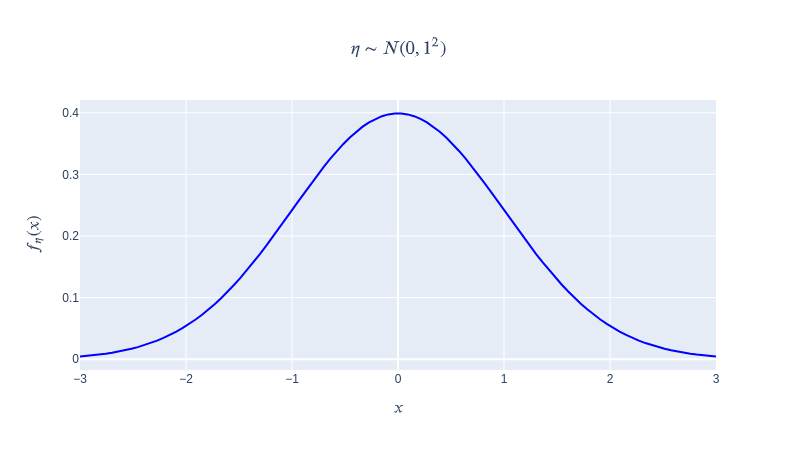

In [137]:
theoretical_norm_PDF = np.vectorize(eta.f)(norm_data_x)

theoretical_norm_PDF_trace = go.Scatter(
    name='PDF',
    legendgroup='PDF',
    x=norm_data_x,
    y=theoretical_norm_PDF,
    line=go.scatter.Line(
        color='blue',
    ),
)

norm_dens_fig = go.Figure(
    data=(theoretical_norm_PDF_trace,),
    layout=go.Layout(
        title=go.layout.Title(
            text=r'$\eta \sim ' + str(eta) + '$',
            x=.5,
        ),
        yaxis=go.layout.YAxis(
            title=go.layout.yaxis.Title(
                text=r'$f_\eta(x)$',
            ),
        ),
        xaxis=go.layout.XAxis(
            title=go.layout.xaxis.Title(
                text=r'$x$',
            ),
        ),
    ),
)
plotly.offline.iplot(norm_dens_fig)

#### Функция распределения

По определению, функция распределения
$F_\eta(x) = \mathbb{P}\left(\, \eta < x \,\right)$. Для непрерывной случайной она определяется как интеграл от функции плотности вероятности:
$$\mathbb{P}\left(\, \eta < x \,\right) = \int_{-\infty}^x f_\eta (x) dx$$.
Подставим и получим: $$F_\xi(k)
= \int_{-\infty}^x \frac{1}{\sigma\sqrt{2\pi}}e^{-\frac{(x-\mu)^2}{2\sigma^2}} dx
= \frac{1}{\sigma\sqrt{2\pi}} \int_{-\infty}^x e^{-\frac{(x-\mu)^2}{2\sigma^2}} dx$$

Построим график этой функции, используя метод `Norm.p`:

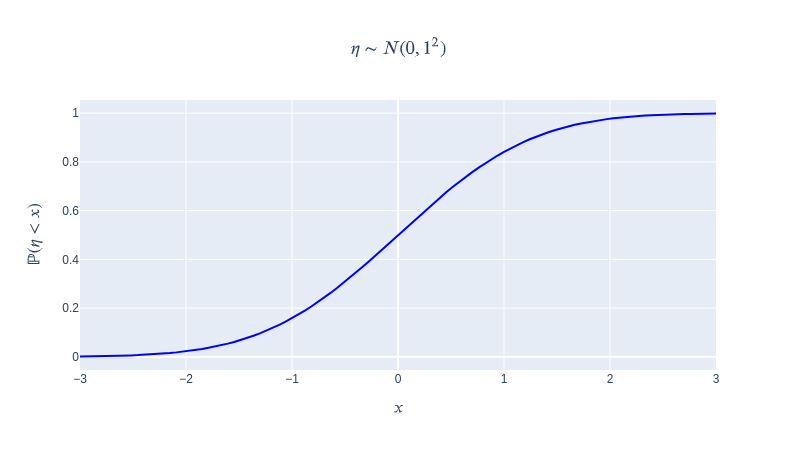

In [138]:
theoretical_norm_CDF = np.vectorize(eta.p)(norm_data_x)

theoretical_norm_CDF_trace = go.Scatter(
    name='CDF',
    legendgroup='CDF',
    x=norm_data_x,
    y=theoretical_norm_CDF,
    line=go.scatter.Line(
        color='blue',
    ),
)

norm_dist_fig = go.Figure(
    data=(theoretical_norm_CDF_trace,),
    layout=go.Layout(
        title=go.layout.Title(
            text=r'$\eta \sim ' + str(eta) + '$',
            x=.5,
        ),
        yaxis=go.layout.YAxis(
            title=go.layout.yaxis.Title(
                text=r'$\mathbb{P}(\eta<x)$',
            ),
        ),
        xaxis=go.layout.XAxis(
            title=go.layout.xaxis.Title(
                text=r'$x$',
            ),
        ),
    ),
)
plotly.offline.iplot(norm_dist_fig)

## Примеры событий и интерпретации

### Гипергеометрическое распределение

#### Типичная интерпретация

Типичной интерпретацией гипергеометрического распределения является выборка без возвращения из множества элементов, некоторые из которых являются помеченными. Представим, что в нашем распоряжении имеется корзина, наполненная шарами двух цветов: черные и белые. Причём всего в корзине находится $N$ шаров, $m$ из которых – белые. Шары в корзине тщательно перемешиваются, чтобы каждый из них мог быть вытащен с одинаковой вероятностью $\frac{1}{N}$. Далее случайно вытаскиваются $n$ шаров без возвращения. Гипергеометрическое распределение описывает вероятность того, что среди вытащенных шаров ровно $k$ окажутся белыми.

Действительно, всего существует $\binom{N}{n}$ выборок размера $n$, $\binom{m}{k}$ способов выбрать $k$ помеченных объектов (белых шаров), и $\binom{N-m}{n-k}$ способов заполнить оставшиеся $n-k$ *слотов* непомеченными объектами (черными шарами). Таким образом, вероятность того, что среди $n$ вытащенных объектов окажется ровно $k$ помеченных, будет равна $\frac{\binom{m}{k}\binom{N-m}{n-k}}{\binom{N}{n}}$.

#### Известные соотношения между распределениями

* Случайная величина, имеющая гипергеометрическое распределение с параметром $n=1$ будет иметь распределение Бернулли с параметром $m/N$:
  $$\left\{\xi \sim HG(N,m,1)\right\} \implies \left\{\xi \sim B\left(\frac{m}{N}\right)\right\}$$
  Действительно, при размере выборки равным единице, случайная величина, имеющая гипергеометрическое распределение, может принимать только два значения $k \in \{0, 1\}$. То есть, нам либо попадется помеченный элемент, либо нет. Тогда эти вероятности описывает распределение Бернулли с вероятностью успеха, равной отношению общего количества элементов к количеству помеченных.

* Если зафиксировать размер выборки и количество помеченных элементов, а мощность множества, из которого ведется выборка, устремить к бесконечности, то гипергеометрическое распределение будет сходиться к биномиальному:
  $$HG(N, m, n) \underset{N\to\infty}{\longrightarrow} Bi\left(n, \frac{m}{N}\right)$$

### Нормальное распределение

#### Типичная интерпретация

Нормальное распределение описывает нормированную случайную величину, которая является суммой многих случайных слабо взаимосвязанных величин, каждая из которых вносит малый вклад относительно общей суммы. Это вытекает из [центральной предельной теоремы](https://ru.wikipedia.org/wiki/Центральная_предельная_теорема).

#### Известные соотношения между распределениями

* Сумма двух независимых случайных величин, имеющих нормальное распределение, имеет [распределение Коши](https://ru.wikipedia.org/wiki/Распределение_Коши):
  $$\begin{aligned}
  \xi\ &\sim\ N(\mu_1, {\sigma_1}^2)\\
  \eta\ &\sim\ N(\mu_2, {\sigma_2}^2)\\
  \xi+\eta\ &\sim\ C(\mu_1 + \mu_2, \sqrt{{\sigma_1}^2 + {\sigma_2}^2})
  \end{aligned}$$

  <!-- http://scask.ru/a_book_tp.php?id=61 -->

* Сумма квадратов $k$ независимых стандартных нормальных случайных величин имеет [распределение $\chi^2$](https://ru.wikipedia.org/wiki/Распределение_хи-квадрат) c $k$ степенями свободы:
  $$\begin{aligned}
  \forall i \in \overline{1, k}\quad \xi_i\ &\sim\ N(0, 1)\\
  \sum_{i=1}^k \xi_i &\sim \chi^2(k)
  \end{aligned}$$

* Натуральный логарифм [логнормального распределения](https://ru.wikipedia.org/wiki/Логнормальное_распределение) имеет нормальное распределение:
  $$\begin{aligned}
  \xi &\sim LogN(\mu,\sigma^2)\\
  \ln\xi &\sim N(\mu,\sigma^2)
  \end{aligned}$$

# Задание №2. Моделирование случайных величин

> Основные алгоритмы моделирования брались из книги Р. Н. Вадзинского ["Справочник по вероятностным распределениям"](http://zyurvas.narod.ru/knigi/Vadzinski_Ver_raspr.pdf)

Объявим константы:

In [139]:
QS = (5, 10, 10**2, 10**3, 10**5)
N = 5

## Гипергеометрическое распределение

Добавим к нашему классу `HG` метод `gen`, который будет возвращать реализацию из $HG(N, m, n)$:

In [140]:
@njit
def gen_hg(N: int, m: int, n: int) -> int:
    x = 0
    for _ in range(n):
        if np.random.rand() < m/N:
            x += 1
            m -= 1
        N -= 1
    return x

HG.gen = lambda self: gen_hg(self.N, self.m, self.n)

Поясню происходящее: `x` – это количество помеченных элементов из тех, что мы выбрали.  

Изначально `x = 0`, потому что мы еще не выбрали ни одного элемента.  

Далее начинаем выбирать `n` элементов. Каждый раз, вероятность того, что мы выберем помеченный элемент равна `m/N`. Мы используем функцию [`numpy.random.rand`](https://docs.scipy.org/doc/numpy/reference/random/index.html), которая возвращает действительное число в интервале $[0, 1)$, и проверяем, меньше ли значение, чем `m/N`. Если это значение меньше, это означает, что мы выбрали один из помеченных элементов. В этом случае, мы увеличиваем `x` на единицу и уменьшаем количество оставшихся помеченных элементов на `1`, потому что выборка ведется без возвращения.  

Также, вне зависимости от того, был ли выбранный объект помеченным, мы уменьшаем количество объектов, из которых ведется выборка, на единицу.  

Этот процесс повторяется ровно `n` раз, так как всего должно быть выбрано `n` элементов.

Для ускорения работы функции (она будет часто вызываться при построении выборок), мы используем декоратор из прекрасной библиотеки [`numba`](http://numba.pydata.org), который при первом вызове функции скомпилирует нашу функцию в машинный код, и, при последующих вызовах, будет вызываться уже скомпилированная функция, которая выполняется во много раз быстрее (в нашем случае прирост в скорости будет около 2000%).

### Генерация выборок

> Объем выборки будем обозначать $q$, чтобы не путать с параметром распреления $n$.

Напишем новый метод `HG.sample_hg(q)`, который будет возвращать выборку объема $q$ из $HG(N, m, n)$:

In [141]:
def sample_hg(N: int, m: int, n: int, q: int) -> np.ndarray:
    return np.fromiter((gen_hg(N, m, n) for _ in range(q)), np.int)

HG.sample = lambda self, q: sample_hg(self.N, self.m, self.n, q)

Для каждого $q\in\{5, 10, 100, 1000, 10^5\}$ сгенерируем по 5 выборок $X_q^i$ объема $q$, где $i\in\overline{1, 5}$

In [142]:
samples_hg = {}

for q in QS:
    samples_hg[q] = np.ndarray(shape=(N, q), dtype=np.int)
    for i in range(N):
        samples_hg[q][i] = xi.sample(q)

Теперь `samples_norm` – словарь, где ключом является объемом выборки, а значением по соответствующему ключу – массив из `N = 5` выборок соответствующего объема из распределения $HG(80, 15, 20)$.  
Выведем выборки для `q = 5` и `q = 10`:

In [143]:
for q in (5, 10):
    print(f'====== q = {q} ======:')
    for i, s in enumerate(samples_hg[q]):
        print(f'#{i+1}: {s}')

====== q = 5 ======:
#1: [9 9 7 8 6]
#2: [8 8 8 8 5]
#3: [ 8  8  8 11  6]
#4: [8 8 5 7 9]
#5: [ 7 10  6  6  7]
====== q = 10 ======:
#1: [ 9 10  5  8  8 11 11  8 11  5]
#2: [ 7  6  8  5  7 12  6  9  8  5]
#3: [7 5 9 9 7 9 7 9 8 8]
#4: [10  7  7  6  9  6  7  7  5 10]
#5: [ 4  6  7  9 10 10  7  7  6  7]


 ### Эмпирическая функция распределения

Для каждой выбоки вычислим эмпирическую функцию распределения (*ECDF*) с помощью функции [`statsmodels.distributions.empirical_distribution.ECDF`](http://www.statsmodels.org/stable/generated/statsmodels.distributions.empirical_distribution.ECDF.html):

In [144]:
HG_ECDFs = {}
for q in samples_hg:
    HG_ECDFs[q] = np.ndarray(shape=(samples_hg[q].shape[0], hg_data_x.shape[0]), dtype=np.float)
    for i, sample in enumerate(samples_hg[q]):
        HG_ECDFs[q][i] = ECDF(sample)(hg_data_x)

Теперь для каждой выборки построим эмпирическую функцию распределения, а также сравним получившуюся функцию с теоретической функцией распределения:

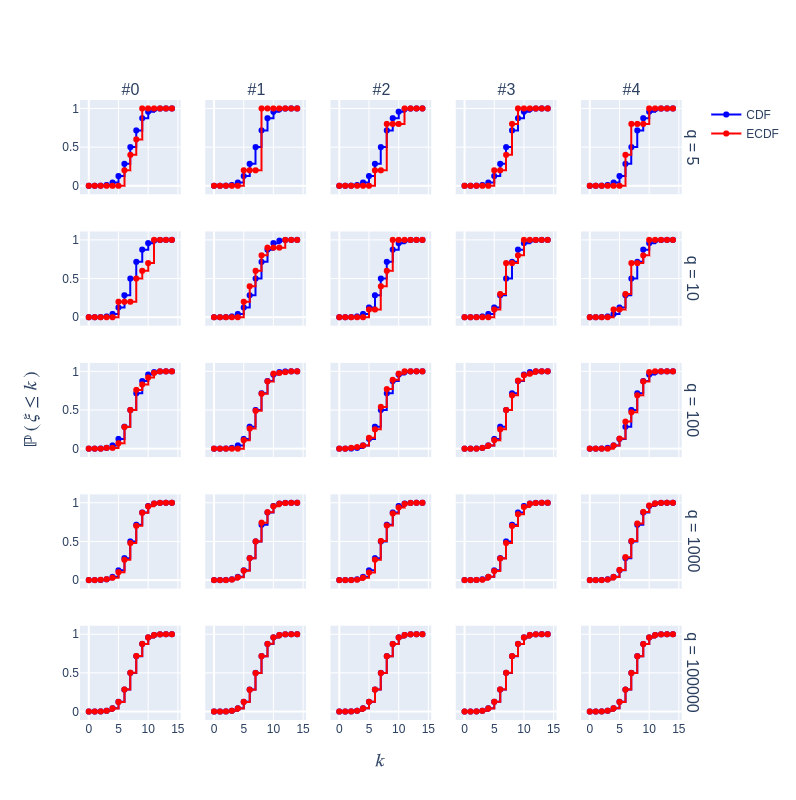

In [145]:
HG_ECDFs_fig = plotly.subplots.make_subplots(rows=len(QS), 
                                    cols=N,
                                    shared_xaxes='all',
                                    shared_yaxes='all',
                                    row_titles=[f'q = {q}' for q in QS],
                                    column_titles=[f'#{i}' for i in range(N)],
                                    x_title=r'$k$',
                                    y_title=r'$\mathbb{P}\left(\,\xi\leq k\,\right)$')

for i, q in enumerate(HG_ECDFs):
    for j, sample in enumerate(HG_ECDFs[q]):
        theoretical_hg_CDF_trace.showlegend = (i + j == 0)
        HG_ECDFs_fig.add_trace(theoretical_hg_CDF_trace, row=i+1, col=j+1)
        HG_ECDFs_fig.add_trace(
            go.Scatter(
                name='ECDF',
                x=hg_data_x,
                y=HG_ECDFs[q][j],
                line=go.scatter.Line(
                    shape='hv',
                    color='red',
                ),
                legendgroup='CDF',
                showlegend=(i + j == 0),
            ),
            row=i+1,
            col=j+1)

HG_ECDFs_fig.update_layout(height=800, width=900)
HG_ECDFs_fig.show()

Все в порядке, ECDF стремится к CDF при увеличении объема выборки.

Для каждого $q\in\{5, 10, 100,1000, 10^5\}$ найдем верхнюю границу разности каждой пары эмпирических функций распределения $\Delta_q^{i,j}$:
$$\Delta_q^{i,j} = \sup\limits_{y\,\in\,\rm{supp}\,\xi}\left(\,\hat{F}\left(y, \overrightarrow{x_i}\right) - \hat{F}\left(y, \overrightarrow{x_j}\right)\,\right), \quad i,j\,\in\overline{0, 5}$$

In [146]:
for q in HG_ECDFs:
    print(f'====== q = {q} ======:')
    for i, ECDF_i in enumerate(HG_ECDFs[q]):
        for j, ECDF_j in enumerate(HG_ECDFs[q][i+1:], start=i+1):
            print(f'i = {i}; j = {j}; max delta = {np.absolute(ECDF_i - ECDF_j).max():.4f}')

====== q = 5 ======:
i = 0; j = 1; max delta = 0.4000
i = 0; j = 2; max delta = 0.2000
i = 0; j = 3; max delta = 0.2000
i = 0; j = 4; max delta = 0.4000
i = 1; j = 2; max delta = 0.2000
i = 1; j = 3; max delta = 0.2000
i = 1; j = 4; max delta = 0.6000
i = 2; j = 3; max delta = 0.2000
i = 2; j = 4; max delta = 0.6000
i = 3; j = 4; max delta = 0.4000
====== q = 10 ======:
i = 0; j = 1; max delta = 0.4000
i = 0; j = 2; max delta = 0.4000
i = 0; j = 3; max delta = 0.5000
i = 0; j = 4; max delta = 0.5000
i = 1; j = 2; max delta = 0.3000
i = 1; j = 3; max delta = 0.1000
i = 1; j = 4; max delta = 0.1000
i = 2; j = 3; max delta = 0.3000
i = 2; j = 4; max delta = 0.3000
i = 3; j = 4; max delta = 0.1000
====== q = 100 ======:
i = 0; j = 1; max delta = 0.0500
i = 0; j = 2; max delta = 0.0700
i = 0; j = 3; max delta = 0.0700
i = 0; j = 4; max delta = 0.0700
i = 1; j = 2; max delta = 0.0600
i = 1; j = 3; max delta = 0.0400
i = 1; j = 4; max delta = 0.0900
i = 2; j = 3; max delta = 0.0800
i = 2; j =

### Построение вариационного ряда выборки
Для каждого $q\in\{5, 10, 100, 1000, 10^5\}$ построим вариационный ряд выборки:

In [147]:
HG_VAR_ROWS = {}
for q in samples_hg:
    HG_VAR_ROWS[q] = np.ndarray(shape=samples_hg[q].shape, dtype=np.int)
    for i, sample in enumerate(samples_hg[q]):
        HG_VAR_ROWS[q][i] = np.sort(sample)

Выведем получившиеся упорядоченные выборки для `q = 5` и `q = 10`:

In [148]:
for q in (5, 10):
    print(f'====== q = {q} ======:')
    for i, s in enumerate(HG_VAR_ROWS[q]):
        print(f'#{i+1}: {s}')

====== q = 5 ======:
#1: [6 7 8 9 9]
#2: [5 8 8 8 8]
#3: [ 6  8  8  8 11]
#4: [5 7 8 8 9]
#5: [ 6  6  7  7 10]
====== q = 10 ======:
#1: [ 5  5  8  8  8  9 10 11 11 11]
#2: [ 5  5  6  6  7  7  8  8  9 12]
#3: [5 7 7 7 8 8 9 9 9 9]
#4: [ 5  6  6  7  7  7  7  9 10 10]
#5: [ 4  6  6  7  7  7  7  9 10 10]


### Квантили
**Квантилью** уровня $\alpha\in(0, 1)$ случайной величины $\xi$ называется такое число $x_\alpha\in\mathbb{R}$, что
$$\begin{aligned}
\mathbb{P}(\,\xi \leq x_\alpha\,) &\geq \alpha \\
\mathbb{P}(\,\xi \geq x_\alpha\,) &\geq 1-\alpha \\
\end{aligned}$$

Найдем квантили уровней $\alpha\in\{0.1, 0.5, 0.7\}$ для гипергеометрического распределения $HG(80, 15, 40)$:

In [149]:
hg_quantiles = {}
for a in (.1, .5, .7):
    for i, y in enumerate(theoretical_hg_CDF):
        if y >= a:
            hg_quantiles[a] = hg_data_x[i]
            print(f'a = {a}, quantile = {hg_quantiles[a]}')
            break

a = 0.1, quantile = 5
a = 0.5, quantile = 7
a = 0.7, quantile = 8


**Выборочная квантиль** уровня $\alpha\in(0, 1)$ выборки $\overrightarrow{X}$ - элемент вариационного ряда этой выборки, стоящий на позиции $\left[\alpha\left|\overrightarrow{X}\right| + 1\right]$.

Для каждой выборки найдем квантили уровней $\alpha\in\{0.1, 0.5, 0.7\}$ и сравним их с соответствующими квантилями данного распределения:

In [150]:
for q in QS:
    print(f'======= q = {q} =======:')
    for a in (.1, .5, .7):
        print(f'------ a = {a} ------')
        for i, sample in enumerate(HG_VAR_ROWS[q]):
            quantile = sample[int(a*sample.shape[0])]
            print(f'#{i}; quantile = {quantile:2}, real delta = {quantile - hg_quantiles[a]:+}')

======= q = 5 =======:
------ a = 0.1 ------
#0; quantile =  6, real delta = +1
#1; quantile =  5, real delta = +0
#2; quantile =  6, real delta = +1
#3; quantile =  5, real delta = +0
#4; quantile =  6, real delta = +1
------ a = 0.5 ------
#0; quantile =  8, real delta = +1
#1; quantile =  8, real delta = +1
#2; quantile =  8, real delta = +1
#3; quantile =  8, real delta = +1
#4; quantile =  7, real delta = +0
------ a = 0.7 ------
#0; quantile =  9, real delta = +1
#1; quantile =  8, real delta = +0
#2; quantile =  8, real delta = +0
#3; quantile =  8, real delta = +0
#4; quantile =  7, real delta = -1
======= q = 10 =======:
------ a = 0.1 ------
#0; quantile =  5, real delta = +0
#1; quantile =  5, real delta = +0
#2; quantile =  7, real delta = +2
#3; quantile =  6, real delta = +1
#4; quantile =  6, real delta = +1
------ a = 0.5 ------
#0; quantile =  9, real delta = +2
#1; quantile =  7, real delta = +0
#2; quantile =  8, real delta = +1
#3; quantile =  7, real delta = +0
#4;

Как и должно было быть, разность между выборочными квантилями и теоретическими стремится к нулю.

> Вообще говоря, для вычисления квантилей выборок можно было воспользоваться функцией [`np.quantile`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.quantile.html), но это было бы слишком просто...

### Гистограмма и полигон частот
Для каждого $q\in\{5, 10, 100, 1000, 10^5\}$ построим гистограмму, а также сравним полученные графики с функцией вероятности $\mathbb{P}\left(\,\xi=k\,\right)$. Полигон частот строить не будем, потому что по сути, это просто альтернативный способ представления гистограммы, который будет нам только мешать анализировать графики.

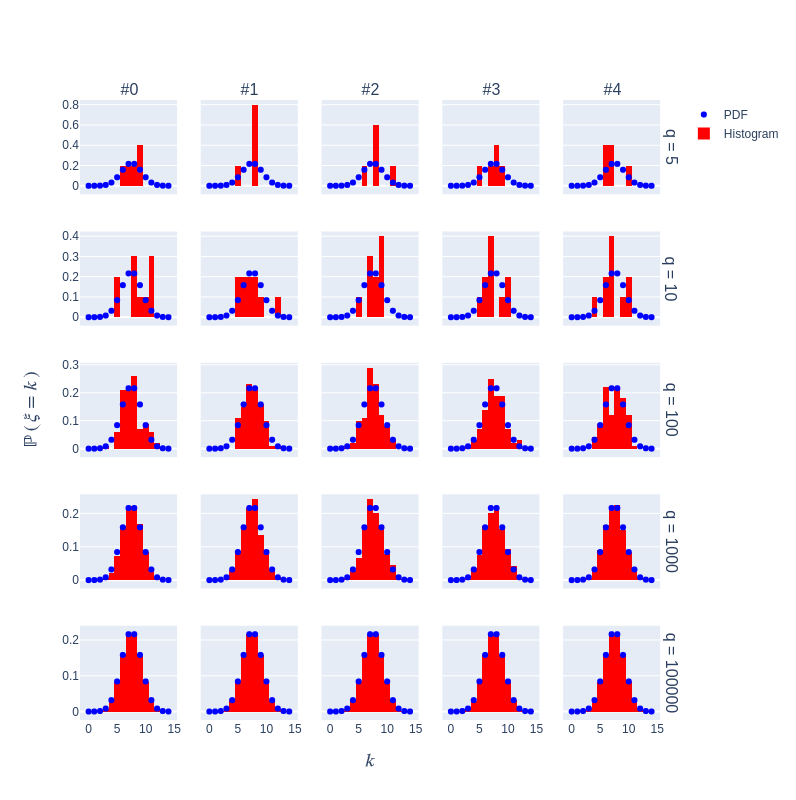

In [151]:
HG_hists_fig = plotly.subplots.make_subplots(rows=len(QS), 
                                    cols=N,
                                    shared_xaxes='all',
                                    shared_yaxes=True,
                                    row_titles=[f'q = {q}' for q in QS],
                                    column_titles=[f'#{i}' for i in range(N)],
                                    x_title=r'$k$',
                                    y_title=r'$\mathbb{P}\left(\,\xi = k\,\right)$')

for i, q in enumerate(samples_hg):
    for j, sample in enumerate(samples_hg[q]):
        theoretical_hg_PDF_trace.showlegend = (i + j == 0)
        HG_hists_fig.add_trace(theoretical_hg_PDF_trace, row=i+1, col=j+1)
        HG_hists_fig.add_trace(
            go.Histogram(
                name='Histogram',
                x=sample,
                histnorm='probability',
                marker_color='red',
                legendgroup='PDF',
                showlegend=(i + j == 0),
            ),
            row=i+1,
            col=j+1)

HG_hists_fig.update_layout(height=800, width=900)
HG_hists_fig.show()

Как мы видим, закон больших чисел подтверждается графиками: с ростом объема выборки, значения гистограммы выборок все сильнее приближаются к истинному функции распределения.

## Нормальное распределение

С помощью формулы из [справочника по вероятностным распределениям](http://zyurvas.narod.ru/knigi/Vadzinski_Ver_raspr.pdf), мы можем получить сразу две реализации $x_i$ и $x_{i+1}$ из стандартного нормального распределения $N(0, 1)$, имея две реализации $r_i$ и $r_{i+1}$ из стандартного равномерного распределения на отрезке $[0, 1]$:
$$\begin{aligned}
x_i &= \sqrt{-2 \ln r_i} \sin(2\pi r_{i+1}) \\
x_{i+1} &= \sqrt{-2 \ln r_i} \cos(2\pi r_{i+1})
\end{aligned}$$

Чтобы получить реализацию $y_i$ из $N(\mu, \sigma)$:
$$y_i = \mu + \sigma x_i$$

Для простоты, мы будем использовать только одну $y_i$ из двух возможных за раз:

In [152]:
@njit
def gen_norm(mu: float, sigma: float) -> float:
    return mu + sigma * \
      np.sqrt(-2 * np.log(np.random.rand())) * \
      np.cos(2 * np.pi * np.random.rand())

Norm.gen = lambda self: gen_norm(self.mu, self.sigma)

### Генерация выборок
> Как говорилось ранее, объем выборки мы будем обозначать $q$.

Напишем метод `HG.sample_norm(q)`, которsq будет возвращать выборку объема $q$ из $N(\mu, \sigma)$:

In [153]:
def sample_norm(mu: float, sigma: float, q: int) -> np.ndarray:
    return np.fromiter((gen_norm(mu, sigma) for _ in range(q)), np.float)

Norm.sample = lambda self, q: sample_norm(self.mu, self.sigma, q)

Для каждого $q\in\{5, 10, 100, 1000, 10^5\}$ сгенерируем по 5 выборок $X_\eta^{q,i}$ объема $q$, где $i\in\overline{1, 5}$

In [154]:
samples_norm = {}

for q in QS:
    samples_norm[q] = np.ndarray(shape=(N, q), dtype=np.float64)
    for i in range(N):
        samples_norm[q][i] = eta.sample(q)

Теперь `samples_norm` – словарь, где ключом является объемом выборки, а значением по соответствующему ключу – массив из N = 5 выборок соответствующего объема.
Выведем выборки для q = 5 и q = 10:

In [155]:
for q in (5, 10):
    print(f'====== q = {q} ======:')
    for i, s in enumerate(samples_norm[q]):
        print(f'#{i+1}: {s}')

====== q = 5 ======:
#1: [ 0.45645  0.47116  1.0084  -0.78835  0.4614 ]
#2: [ 0.68189  0.05317  0.91513  0.19643 -0.79518]
#3: [-0.84065 -0.55653 -0.88095 -0.2995  -0.11839]
#4: [ 1.1473  -1.52487 -0.05156 -1.2362   0.66415]
#5: [ 0.90875 -0.00851  0.45759 -1.19757  1.8953 ]
====== q = 10 ======:
#1: [ 1.5083  -0.32563 -0.66343 -0.2004  -0.9329   0.3279   0.74936  1.78207  0.16416 -0.00322]
#2: [-0.56827  0.57372 -0.7124   0.64847  0.257   -0.0977  -1.24337  0.28943  0.52108 -0.30138]
#3: [-0.92721 -0.91058 -0.70247  0.82201  0.15957  0.9237   1.49135 -1.10268  1.48987 -1.00538]
#4: [ 0.38634 -0.36784 -1.27815 -1.16587  1.01066 -1.04284 -1.2109   0.65975 -1.23789 -0.17612]
#5: [ 0.68289 -1.11849 -0.23599 -1.11372  0.18617 -0.15764 -1.84052 -0.36211  0.85955  1.44243]


### Эмпирическая функция распределения

Для каждой выбоки вычислим эмпирическую функцию распределения (*ECDF*) с помощью функции [`statsmodels.distributions.empirical_distribution.ECDF`](http://www.statsmodels.org/stable/generated/statsmodels.distributions.empirical_distribution.ECDF.html):

In [156]:
Norm_ECDFs = {}
for q in samples_norm:
    Norm_ECDFs[q] = np.ndarray(shape=(samples_norm[q].shape[0], norm_data_x.shape[0]), dtype=np.float)
    for i, sample in enumerate(samples_norm[q]):
        Norm_ECDFs[q][i] = ECDF(sample)(norm_data_x)

Теперь для каждой выборки построим эмпирическую функцию распределения, а также сравним получившуюся функцию с теоретической функцией распределения:

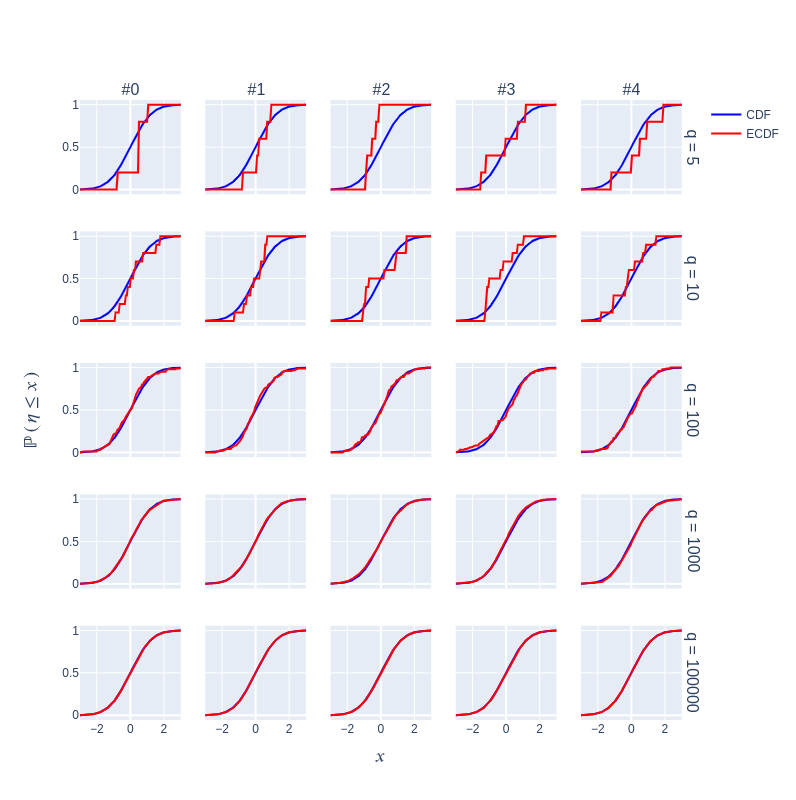

In [157]:
Norm_ECDFs_fig = plotly.subplots.make_subplots(rows=len(QS), 
                                    cols=N,
                                    shared_xaxes='all',
                                    shared_yaxes='all',
                                    row_titles=[f'q = {q}' for q in QS],
                                    column_titles=[f'#{i}' for i in range(N)],
                                    x_title=r'$x$',
                                    y_title=r'$\mathbb{P}\left(\,\eta\leq x\,\right)$')

for i, q in enumerate(Norm_ECDFs):
    for j, sample in enumerate(Norm_ECDFs[q]):
        theoretical_norm_CDF_trace.showlegend = (i + j == 0)
        Norm_ECDFs_fig.add_trace(theoretical_norm_CDF_trace, row=i+1, col=j+1)
        Norm_ECDFs_fig.add_trace(
            go.Scatter(
                name='ECDF',
                x=norm_data_x,
                y=Norm_ECDFs[q][j],
                line=go.scatter.Line(
                    color='red',
                ),
                legendgroup='CDF',
                showlegend=(i + j == 0),
            ),
            row=i+1,
            col=j+1)

Norm_ECDFs_fig.update_layout(height=800, width=900)
Norm_ECDFs_fig.show()

Тут опять все хорошо, значения ECDF стремятся к CDF при стремлении объема выборки к бесконечности.

Для каждого $q\in\{5, 10, 100,1000, 10^5\}$ найдем верхнюю границу разности каждой пары эмпирических функций распределения $\Delta_q^{i,j}$:
$$\Delta_q^{i,j} = \sup\limits_{y\,\in\,\rm{supp}\,\eta}\left(\,\hat{F}\left(y, \overrightarrow{x_i}\right) - \hat{F}\left(y, \overrightarrow{x_j}\right)\,\right), \quad i,j\,\in\overline{0, 5}$$

In [158]:
for q in Norm_ECDFs:
    print(f'====== q = {q} ======:')
    for i, ECDF_i in enumerate(Norm_ECDFs[q]):
        for j, ECDF_j in enumerate(Norm_ECDFs[q][i+1:], start=i+1):
            print(f'i = {i}; j = {j}; max delta = {np.absolute(ECDF_i - ECDF_j).max():.4f}')

====== q = 5 ======:
i = 0; j = 1; max delta = 0.4000
i = 0; j = 2; max delta = 0.8000
i = 0; j = 3; max delta = 0.4000
i = 0; j = 4; max delta = 0.2000
i = 1; j = 2; max delta = 0.8000
i = 1; j = 3; max delta = 0.4000
i = 1; j = 4; max delta = 0.2000
i = 2; j = 3; max delta = 0.6000
i = 2; j = 4; max delta = 0.8000
i = 3; j = 4; max delta = 0.4000
====== q = 10 ======:
i = 0; j = 1; max delta = 0.3000
i = 0; j = 2; max delta = 0.4000
i = 0; j = 3; max delta = 0.5000
i = 0; j = 4; max delta = 0.3000
i = 1; j = 2; max delta = 0.4000
i = 1; j = 3; max delta = 0.4000
i = 1; j = 4; max delta = 0.2000
i = 2; j = 3; max delta = 0.4000
i = 2; j = 4; max delta = 0.2000
i = 3; j = 4; max delta = 0.3000
====== q = 100 ======:
i = 0; j = 1; max delta = 0.0900
i = 0; j = 2; max delta = 0.0600
i = 0; j = 3; max delta = 0.1400
i = 0; j = 4; max delta = 0.1000
i = 1; j = 2; max delta = 0.0900
i = 1; j = 3; max delta = 0.1400
i = 1; j = 4; max delta = 0.1300
i = 2; j = 3; max delta = 0.1100
i = 2; j =

### Построение вариационного ряда выборки

### Построение вариационного ряда выборки
Для каждого $q\in\{5, 10, 100, 1000, 10^5\}$ построим вариационный ряд выборки:

In [159]:
Norm_VAR_ROWS = {}
for q in samples_norm:
    Norm_VAR_ROWS[q] = np.ndarray(shape=samples_norm[q].shape, dtype=np.float64)
    for i, sample in enumerate(samples_norm[q]):
        Norm_VAR_ROWS[q][i] = np.sort(sample)

Выведем получившиеся упорядоченные выборки для `q = 5` и `q = 10`:

In [160]:
for q in (5, 10):
    print(f'====== q = {q} ======:')
    for i, s in enumerate(Norm_VAR_ROWS[q]):
        print(f'#{i+1}: {s}')

====== q = 5 ======:
#1: [-0.78835  0.45645  0.4614   0.47116  1.0084 ]
#2: [-0.79518  0.05317  0.19643  0.68189  0.91513]
#3: [-0.88095 -0.84065 -0.55653 -0.2995  -0.11839]
#4: [-1.52487 -1.2362  -0.05156  0.66415  1.1473 ]
#5: [-1.19757 -0.00851  0.45759  0.90875  1.8953 ]
====== q = 10 ======:
#1: [-0.9329  -0.66343 -0.32563 -0.2004  -0.00322  0.16416  0.3279   0.74936  1.5083   1.78207]
#2: [-1.24337 -0.7124  -0.56827 -0.30138 -0.0977   0.257    0.28943  0.52108  0.57372  0.64847]
#3: [-1.10268 -1.00538 -0.92721 -0.91058 -0.70247  0.15957  0.82201  0.9237   1.48987  1.49135]
#4: [-1.27815 -1.23789 -1.2109  -1.16587 -1.04284 -0.36784 -0.17612  0.38634  0.65975  1.01066]
#5: [-1.84052 -1.11849 -1.11372 -0.36211 -0.23599 -0.15764  0.18617  0.68289  0.85955  1.44243]


### Квантили

Найдем квантили уровней $\alpha\in\{0.1, 0.5, 0.7\}$ для нормального распределения $N(0, 1^2)$:

In [161]:
norm_quantiles = {}
for a in (.1, .5, .7):
    for i, y in enumerate(theoretical_norm_CDF):
        if y >= a:
            norm_quantiles[a] = norm_data_x[i]
            print(f'a = {a}, quantile = {norm_quantiles[a]:+.4f}')
            break

a = 0.1, quantile = -1.2424
a = 0.5, quantile = +0.0303
a = 0.7, quantile = +0.5758


Теперь для каждой выборки найдем *выборочные квантили* уровней $\alpha\in\{0.1, 0.5, 0.7\}$ и сравним их с соответствующими квантилями данного распределения:

In [162]:
for q in QS:
    print(f'======= q = {q} =======:')
    for a in (.1, .5, .7):
        print(f'------ a = {a} ------')
        for i, sample in enumerate(Norm_VAR_ROWS[q]):
            quantile = sample[int(a*sample.shape[0])]
            print(f'#{i}; quantile = {quantile:+2.3f}, real delta = {quantile - norm_quantiles[a]:+2.3f}')

======= q = 5 =======:
------ a = 0.1 ------
#0; quantile = -0.788, real delta = +0.454
#1; quantile = -0.795, real delta = +0.447
#2; quantile = -0.881, real delta = +0.361
#3; quantile = -1.525, real delta = -0.282
#4; quantile = -1.198, real delta = +0.045
------ a = 0.5 ------
#0; quantile = +0.461, real delta = +0.431
#1; quantile = +0.196, real delta = +0.166
#2; quantile = -0.557, real delta = -0.587
#3; quantile = -0.052, real delta = -0.082
#4; quantile = +0.458, real delta = +0.427
------ a = 0.7 ------
#0; quantile = +0.471, real delta = -0.105
#1; quantile = +0.682, real delta = +0.106
#2; quantile = -0.299, real delta = -0.875
#3; quantile = +0.664, real delta = +0.088
#4; quantile = +0.909, real delta = +0.333
======= q = 10 =======:
------ a = 0.1 ------
#0; quantile = -0.663, real delta = +0.579
#1; quantile = -0.712, real delta = +0.530
#2; quantile = -1.005, real delta = +0.237
#3; quantile = -1.238, real delta = +0.005
#4; quantile = -1.118, real delta = +0.124
-----

Как и в случае с гипергеометрическим распределением, разность между выборочными квантилями и теоретическими стремится к нулю, что есть правильно.

### Гистограмма и полигон частот
Для каждого $q\in\{5, 10, 100, 1000, 10^5\}$ построим гистограмму, а также сравним полученные графики с плотностью распределения $f_\eta(x)$. Как и в соответствующем пункте про гипергеометрическое распределение, полигон частот строить не будем.

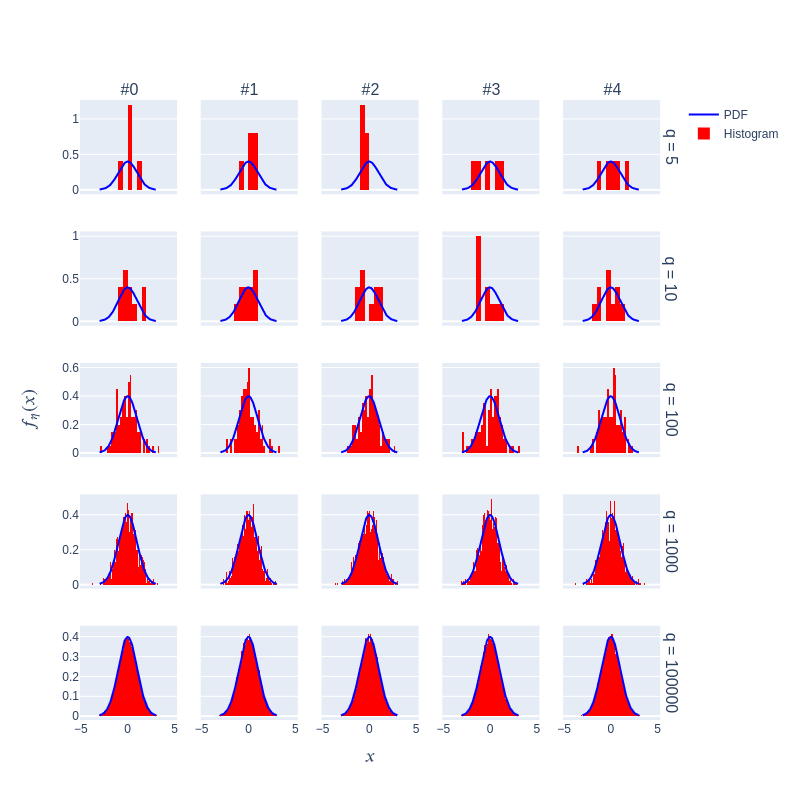

In [163]:
Norm_hists_fig = plotly.subplots.make_subplots(rows=len(QS), 
                                    cols=N,
                                    shared_xaxes='all',
                                    shared_yaxes=True,
                                    row_titles=[f'q = {q}' for q in QS],
                                    column_titles=[f'#{i}' for i in range(N)],
                                    x_title=r'$x$',
                                    y_title=r'$f_\eta(x)$')

for i, q in enumerate(samples_norm):
    for j, sample in enumerate(samples_norm[q]):
        theoretical_norm_PDF_trace.showlegend = (i + j == 0)
        Norm_hists_fig.add_trace(theoretical_norm_PDF_trace, row=i+1, col=j+1)
        Norm_hists_fig.add_trace(
            go.Histogram(
                name='Histogram',
                x=sample,
                histnorm='probability density',
                marker_color='red',
                legendgroup='PDF',
                showlegend=(i + j == 0),
            ),
            row=i+1,
            col=j+1)

Norm_hists_fig.update_layout(height=800, width=900)
Norm_hists_fig.show()

Как мы видим, закон больших чисел снова подтверждается графиками: с ростом объема выборки, значения гистограммы выборок все сильнее приближаются к истинному значению плотности вероятности.

# Задание 3. Оценки
## Гипергеометрическое распределение
### Выборочные среднее и дисперсия
Для начала, для каждой выборки найдем выборочное среднее $\overline{X}$, выборочную дисперсию $S_n^2$ и несмещенную выборочную дисперсию $S^2$ по формулам:
$$\begin{aligned}
    \overline{X} &= \frac{1}{n} \sum_{i=1}^n X_i\\
           S_n^2 &= \frac{1}{n} \sum_{i=1}^n \left(X_i - \overline{X} \right)^2\\
             S^2 &= \frac{n}{n-1} S_n^2
\end{aligned}$$
Также сравним их с истинным значением среднего (математического ожидания) или дисперсии нашей случайной величины:

In [164]:
for q in samples_hg:
    print(f'======= q = {q} =======:')
    for i, sample in enumerate(samples_hg[q]):
        mean = np.sum(sample)/sample.shape[0]
        variance = np.sum((sample-mean)**2)/sample.shape[0]
        unbiased_variance = sample.shape[0] / (sample.shape[0] - 1) * variance
        print(f'''#{i} mean: {mean:20.4f}, real delta: {mean - xi.expected:+.4f}
   variance: {variance:16.4f}, real delta: {variance - (sample.shape[0] - 1) / sample.shape[0] * xi.variance:+.4f}
   unbiased variance: {unbiased_variance:7.4f}, real delta: {unbiased_variance - xi.variance:+.4f}\n''')

======= q = 5 =======:
#0 mean:               7.8000, real delta: +0.3000
   variance:           1.3600, real delta: -1.1084
   unbiased variance:  1.7000, real delta: -1.3854

#1 mean:               7.4000, real delta: -0.1000
   variance:           1.4400, real delta: -1.0284
   unbiased variance:  1.8000, real delta: -1.2854

#2 mean:               8.2000, real delta: +0.7000
   variance:           2.5600, real delta: +0.0916
   unbiased variance:  3.2000, real delta: +0.1146

#3 mean:               7.4000, real delta: -0.1000
   variance:           1.8400, real delta: -0.6284
   unbiased variance:  2.3000, real delta: -0.7854

#4 mean:               7.2000, real delta: -0.3000
   variance:           2.1600, real delta: -0.3084
   unbiased variance:  2.7000, real delta: -0.3854

======= q = 10 =======:
#0 mean:               8.6000, real delta: +1.1000
   variance:           4.6400, real delta: +1.8631
   unbiased variance:  5.1556, real delta: +2.0701

#1 mean:               7.3000

### Нахождение параметров распределения
Мы будем оценивать параметр $N$ для $HG(N, m, n)$. Это может быть полезно, если мы хотим оценить мощность множетсва, из которого ведется выборка, зная количество помеченных элементов $m$ и объем выборки $n$. Для нахождения оценки мы будем использовать статистику $T\left(\overrightarrow{X}\right)$, определенную как выборочное среднее:
$$T\left(\overrightarrow{X}\right) = \overline{X} = \frac{1}{n}\sum_{i=1}^n x_i$$
Посчитаем математическое ожидание $T\left(\overrightarrow{X}\right)$, учитывая, что $\overrightarrow{X} = \left(X_1,X_2,\ldots,X_n\right)$ - назависимые одинаково распределенные случайные величины:
$$\begin{aligned}
    \mathbb{E}\left[\,T\left(\overrightarrow{X}\right)\,\right] &= \mathbb{E}\left[\,\overline{X}\,\right] = \mathbb{E}\left[\,\frac{1}{n}\sum_{i=1}^n x_i\,\right] = \\
    &= \frac{1}{n}\mathbb{E}\left[\,\sum_{i=1}^n x_i\,\right] = \frac{1}{n} \sum_{i=1}^n \mathbb{E}\left[\,x_i\,\right] = \\
    &= \frac{n}{n} \mathbb{E}\left[\,x_1\,\right] = \mathbb{E}\left[\,x_1\,\right] = \\
    &= \frac{m\cdot n}{N} \neq N
\end{aligned}$$
Таким образом, статистика $T\left(\overrightarrow{X}\right)$ является смещенной оценкой для параметра $N$.  
С помощью метода моментов находим оценку $\hat{N} = \frac{m\cdot n}{\overline{X}}$. Оценка является состоятельной, так как:
$$\hat{N} \overset{\mathbb{P}}{\longrightarrow} N$$.

Теперь найдем значения оценки $\hat{N}$ от постоенных выборок и сравним эти значения с истинным значением $N$:

In [165]:
for q in samples_hg:
    print(f'======= q = {q} =======:')
    for i, sample in enumerate(samples_hg[q]):
        mean = np.sum(sample)/sample.shape[0]
        N_hat = xi.m * xi.n / mean
        print(f'''#{i} N_hat: {N_hat:7.4f},\treal delta: {N_hat - xi.N:+10.4f}''')

======= q = 5 =======:
#0 N_hat: 76.9231,	real delta:    -3.0769
#1 N_hat: 81.0811,	real delta:    +1.0811
#2 N_hat: 73.1707,	real delta:    -6.8293
#3 N_hat: 81.0811,	real delta:    +1.0811
#4 N_hat: 83.3333,	real delta:    +3.3333
======= q = 10 =======:
#0 N_hat: 69.7674,	real delta:   -10.2326
#1 N_hat: 82.1918,	real delta:    +2.1918
#2 N_hat: 76.9231,	real delta:    -3.0769
#3 N_hat: 81.0811,	real delta:    +1.0811
#4 N_hat: 82.1918,	real delta:    +2.1918
======= q = 100 =======:
#0 N_hat: 78.5340,	real delta:    -1.4660
#1 N_hat: 78.7402,	real delta:    -1.2598
#2 N_hat: 81.4111,	real delta:    +1.4111
#3 N_hat: 78.9474,	real delta:    -1.0526
#4 N_hat: 80.4290,	real delta:    +0.4290
======= q = 1000 =======:
#0 N_hat: 79.0097,	real delta:    -0.9903
#1 N_hat: 80.0854,	real delta:    +0.0854
#2 N_hat: 78.9162,	real delta:    -1.0838
#3 N_hat: 79.0306,	real delta:    -0.9694
#4 N_hat: 80.5694,	real delta:    +0.5694
======= q = 100000 =======:
#0 N_hat: 80.0467,	real delta:    

Как можно заметить, при увеличении объема выборки, разность между значением оценки и оцениваемым параметром $\hat{N} - N$ стремится к нулю, что подтверждает то, что нашал оценка $\hat{N}$ является состоятельной.

## Нормальное распределение
### Выборочные среднее и дисперсия
Для каждой выборки найдем выборочное среднее, выборочную дисперсию и несмещенную выборочную дисперсию и сравним их с истинными значениями для нашео распределения:

In [166]:
for q in samples_norm:
    print(f'======= q = {q} =======:')
    for i, sample in enumerate(samples_norm[q]):
        mean = np.sum(sample)/sample.shape[0]
        variance = np.sum((sample - mean) ** 2) / sample.shape[0]
        unbiased_variance = sample.shape[0] / (sample.shape[0] - 1) * variance
        print(f'''#{i} mean: {mean:20.4f}, real delta: {mean - eta.expected:+.4f}
   variance: {variance:16.4f}, real delta: {variance - (sample.shape[0] - 1) / sample.shape[0] * eta.variance:+.4f}
   unbiased variance: {unbiased_variance:7.4f}, real delta: {unbiased_variance - eta.variance:+.4f}\n''')

======= q = 5 =======:
#0 mean:               0.3218, real delta: +0.3218
   variance:           0.3528, real delta: -0.4472
   unbiased variance:  0.4409, real delta: -0.5591

#1 mean:               0.2103, real delta: +0.2103
   variance:           0.3510, real delta: -0.4490
   unbiased variance:  0.4388, real delta: -0.5612

#2 mean:              -0.5392, real delta: -0.5392
   variance:           0.0885, real delta: -0.7115
   unbiased variance:  0.1106, real delta: -0.8894

#3 mean:              -0.2002, real delta: -0.2002
   variance:           1.0826, real delta: +0.2826
   unbiased variance:  1.3533, real delta: +0.3533

#4 mean:               0.4111, real delta: +0.4111
   variance:           1.0433, real delta: +0.2433
   unbiased variance:  1.3041, real delta: +0.3041

======= q = 10 =======:
#0 mean:               0.2406, real delta: +0.2406
   variance:           0.7024, real delta: -0.1976
   unbiased variance:  0.7805, real delta: -0.2195

#1 mean:              -0.0633

### Нахождение параметров распределения
Будем оценивать параметр $\mu$ для $N(\mu, \sigma^2)$. Здесь интуиция сразу подсказывает опять брать статистику $T\left(\overrightarrow{X}\right) = \overline{X}$, потому что математическое ожидание нормального рспределения равно $\mu$.
$$\mathbb{E}\left[\,\overline{X}\,\right] = \mathbb{E}\left[\,X_1\,\right] = \mu$$
Как и ожидалось, статистика $T\left(\overrightarrow{X}\right)$ является несмещенной оценкой для параметра $\mu$. Также она является состоятельной и эффективной.

Теперь найдем значения оценки $\hat{\mu}$ от постоенных выборок и сравним эти значения с истинным значением $\mu$:

In [167]:
for q in samples_norm:
    print(f'======= q = {q} =======:')
    for i, sample in enumerate(samples_norm[q]):
        mu_hat = np.sum(sample) / sample.shape[0]
        print(f'''#{i} mu_hat: {mu_hat:7.4f},\treal delta: {mu_hat - eta.mu:+10.4f}''')

======= q = 5 =======:
#0 mu_hat:  0.3218,	real delta:    +0.3218
#1 mu_hat:  0.2103,	real delta:    +0.2103
#2 mu_hat: -0.5392,	real delta:    -0.5392
#3 mu_hat: -0.2002,	real delta:    -0.2002
#4 mu_hat:  0.4111,	real delta:    +0.4111
======= q = 10 =======:
#0 mu_hat:  0.2406,	real delta:    +0.2406
#1 mu_hat: -0.0633,	real delta:    -0.0633
#2 mu_hat:  0.0238,	real delta:    +0.0238
#3 mu_hat: -0.4423,	real delta:    -0.4423
#4 mu_hat: -0.1657,	real delta:    -0.1657
======= q = 100 =======:
#0 mu_hat: -0.0503,	real delta:    -0.0503
#1 mu_hat:  0.0073,	real delta:    +0.0073
#2 mu_hat: -0.0127,	real delta:    -0.0127
#3 mu_hat: -0.0069,	real delta:    -0.0069
#4 mu_hat:  0.0324,	real delta:    +0.0324
======= q = 1000 =======:
#0 mu_hat: -0.0045,	real delta:    -0.0045
#1 mu_hat: -0.0146,	real delta:    -0.0146
#2 mu_hat: -0.0176,	real delta:    -0.0176
#3 mu_hat: -0.0609,	real delta:    -0.0609
#4 mu_hat:  0.0485,	real delta:    +0.0485
======= q = 100000 =======:
#0 mu_hat: -0.

Как можно заметить, при увеличении объема выборки, разность между значением оценки и оцениваемым параметром $\hat{\mu} - \mu$ стремится к нулю, что подтверждает то, что нашал оценка $\hat{\mu}$ является состоятельной.

Теперь попытаемся оценить параметр $\sigma^2$ для $N(\mu, \sigma^2)$. Интуиция снова нас не подводит и предлагает использовать выборочную дисперсию:
$$T\left(\overrightarrow{X}\right) = S_n^2 = \frac{1}{n} \sum_{i=1}^n \left(X_i - \overline{X} \right)^2$$
Судя по названию, *выборочная дисперсия* должна оказаться *несмещенной* оценкой для нашего параметра $\sigma^2$, который как раз и является дисперсией нашего распределения. Проверим это:
$$\begin{aligned}
    \mathbb{E}\left[\,S^2\,\right] &= \mathbb{E}\left[\,\frac{1}{n} \sum_{i=1}^n \left(X_i - \overline{X} \right)^2\,\right] = \frac{1}{n} \sum_{i=1}^n \mathbb{E}\left[\,\left(X_i - \overline{X} \right)^2\,\right] = \\
    &= \mathbb{E}\left[\,\left(X_i - \overline{X} \right)^2\,\right] = \sigma^2
\end{aligned}$$

In [168]:
for q in samples_norm:
    print(f'======= q = {q} =======:')
    for i, sample in enumerate(samples_norm[q]):
        mean = np.sum(sample)/sample.shape[0]
        sigma_2_hat = np.sum((sample - mean) ** 2) / sample.shape[0]
        print(f'''#{i} sigma_2_hat: {sigma_2_hat:7.4f},\treal delta: {sigma_2_hat - eta.sigma ** 2:+10.4f}''')

======= q = 5 =======:
#0 sigma_2_hat:  0.3528,	real delta:    -0.6472
#1 sigma_2_hat:  0.3510,	real delta:    -0.6490
#2 sigma_2_hat:  0.0885,	real delta:    -0.9115
#3 sigma_2_hat:  1.0826,	real delta:    +0.0826
#4 sigma_2_hat:  1.0433,	real delta:    +0.0433
======= q = 10 =======:
#0 sigma_2_hat:  0.7024,	real delta:    -0.2976
#1 sigma_2_hat:  0.3608,	real delta:    -0.6392
#2 sigma_2_hat:  1.0402,	real delta:    +0.0402
#3 sigma_2_hat:  0.6895,	real delta:    -0.3105
#4 sigma_2_hat:  0.9136,	real delta:    -0.0864
======= q = 100 =======:
#0 sigma_2_hat:  1.1240,	real delta:    +0.1240
#1 sigma_2_hat:  0.9803,	real delta:    -0.0197
#2 sigma_2_hat:  1.0297,	real delta:    +0.0297
#3 sigma_2_hat:  1.3829,	real delta:    +0.3829
#4 sigma_2_hat:  1.0451,	real delta:    +0.0451
======= q = 1000 =======:
#0 sigma_2_hat:  1.0247,	real delta:    +0.0247
#1 sigma_2_hat:  0.9652,	real delta:    -0.0348
#2 sigma_2_hat:  1.1145,	real delta:    +0.1145
#3 sigma_2_hat:  0.9558,	real delta:  

Как можно заметить, при увеличении объема выборки, разность между значением оценки и оцениваемым параметром $\hat{\sigma^2} - \sigma^2$ стремится к нулю, что подтверждает то, что наша оценка $\hat{\sigma^2}$ является состоятельной.

# Задание 4. Проверка гипотиз о виде распределения

## 4.1. Проверка гипотез о виде распределения

Определим уровни значимости $\alpha \in \{0.1, 0.05\}$ и объемы выборок для наших критериев:

In [169]:
sign_levels = (0.1, 0.05)
test_volumes = [q for q in QS if q >= 10**3]

### Критерий согласия Колмогорова

Сам _критерий Колмогорова_ формулируется следующим образом:

> Если объем $n \geq 20$ выборки $X_n$ и при выбранном уровне значимости $\alpha$ число $\lambda_\alpha$ определено соотношением $K(\lambda_\alpha) = 1 - \alpha$, то
$$\boxed{
  \left\{H_0 \ \text{отвергается}\ \right\} \iff \left\{ \sqrt{n} \cdot D_n(X) \geq \lambda_\alpha \right\}
}$$
, где:
> * $H_0$ - гипотеза, утверждающая, что распредление $\xi$ имеет функцию распределения $F_\xi(x) = F(x)$, где $F(x)$ полностью задана
> * $K(x)$ - распределение Колмогорова, имеющее функцию распределения $F_K (x)$:
$$F_K(x) = \begin{cases}
  \sum\limits_{k\in\mathbb{Z}} (-1)^k e^{-2 k^2 x^2}, &x>0; \\
  0, &x\leq 0.
\end{cases}$$
> * $D_n(X)$ определяется как максимум (по $x\in\mathbb{R}$) квадрата отклонения эмпирической функции распределения $\hat{F}_X (x)$, построенной по выборке $X$ из распределения $\xi$, от теоретической функции распределения $F_\xi(x)$:
$$D_n(X) = \sup\limits_{x\in\mathbb{R}} \left| \hat{F}_X (x) - F_\xi(x) \right|$$

В практических целях, статистику $D_n(X)$ бывает удобнее вычислять по формуле $D_n(X) = \max(D_n^+(X), D_n^-(X))$, где
$$\begin{aligned}
  D_n^+(X) &= \max\limits_{k\in\overline{1,n}}\left( \frac{k}{n} - F(X_{(k)}) \right)\\
  D_n^-(X) &= \max\limits_{k\in\overline{1,n}}\left( F(X_{(k)}) - \frac{k-1}{n} \right)
\end{aligned}$$
, а $X_{(1)} \leq X_{(2)} \leq \dots \leq X_{(n)}$ - вариационный ряд выборки.

Также, предлагается вместо статистики $D_n(X)$ использовать следующий вид статистики с поправкой Большева, который сходится к распределению Колмогорова со скоростью $O\left(\frac{1}{n^2}\right)$:
$$S_n(X)=\frac{6n\cdot D_n(X)+1}{6\sqrt{n}}$$
Это позволит использовать данный критерий при меньших объемах выборки.
#### Преимущества

* Невысокая нижняя граница для объема выборки $n\geq 20$

#### Недостатки

* Применение данного критерия возможно только для непрерывных распределений (о множестве значений случайной величины обычно судят, исходя из её физической природы)

#### Реализация для нормального распределения

Для начала, определим функцию $D_n(X)$:

In [268]:
@njit
def Dn(cdf_data: np.ndarray, ecdf_data: np.ndarray) -> np.float64:
    return np.absolute(ecdf_data - cdf_data).max()

Возьмем выбоки $X_\eta^q$ объемов $q\in\{10^3,10^5\}$ из нормального распределения $N(0,1^2)$ и для каждого уровня значимости $\alpha \in \{0.1, 0.05\}$ посчитаем, выполняется ли критерий Колмогорова для гипотезы $H_0$, утверждающей, имеет ли исследуемая случайная величина нормальное распределение $N(0, 1^2)$. Если критерий Колмогорова выполняется, то мы принимаем гипотезу $H_0$, иначе - отвергаем.

Будем использовать функцию `cdf` класса распределения Колмогорова [`scipy.stats.kstwobign`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.kstwobign.html#scipy.stats.kstwobign), которая возвращает значение вероятности Колмогорова для:
$$P\left(\sqrt{n} \cdot D_n(X) \leq \alpha \right)$$

In [292]:
for sign_level in sign_levels:
    print(f'\n=================== Уровень значимости: {sign_level:4} ===================')
    for q in test_volumes:
        print(f'--------------------- Объем выборки: {q:6} --------------------')
        for i, ecdf in enumerate(Norm_ECDFs[q]):
            D = Dn(theoretical_norm_CDF, ecdf)
            Kn = np.sqrt(q) * D
            prob_deny = sp.stats.kstwobign.cdf(Kn)
            deny = (prob_deny <= sign_level)
            print(f'#{i+1}: P( sqrt(n)*Dn <= {Kn:.2f}) = {prob_deny:.4f} {"≤" if deny else ">"} {sign_level:.4f} '\
                  f'→ H0 {"не" if not deny else "  "} отвергается')


=================== Уровень значимости:  0.1 ===================
--------------------- Объем выборки:   1000 --------------------
#1: P( sqrt(n)*Dn <= 0.47) = 0.0193 ≤ 0.1000 → H0    отвергается
#2: P( sqrt(n)*Dn <= 0.55) = 0.0733 ≤ 0.1000 → H0    отвергается
#3: P( sqrt(n)*Dn <= 0.77) = 0.4061 > 0.1000 → H0 не отвергается
#4: P( sqrt(n)*Dn <= 1.03) = 0.7625 > 0.1000 → H0 не отвергается
#5: P( sqrt(n)*Dn <= 0.85) = 0.5363 > 0.1000 → H0 не отвергается
--------------------- Объем выборки: 100000 --------------------
#1: P( sqrt(n)*Dn <= 0.34) = 0.0002 ≤ 0.1000 → H0    отвергается
#2: P( sqrt(n)*Dn <= 0.65) = 0.2138 > 0.1000 → H0 не отвергается
#3: P( sqrt(n)*Dn <= 0.75) = 0.3709 > 0.1000 → H0 не отвергается
#4: P( sqrt(n)*Dn <= 0.92) = 0.6300 > 0.1000 → H0 не отвергается
#5: P( sqrt(n)*Dn <= 0.86) = 0.5478 > 0.1000 → H0 не отвергается

=================== Уровень значимости: 0.05 ===================
--------------------- Объем выборки:   1000 --------------------
#1: P( sqrt(n)*Dn <= 0.

Как мы видим, чем больше уровень значимости, тем чаще отвергается гипотеза при меньших объемах выборки, несмотря на то, что, на самом деле, гипотеза истинна, так как выборки `Norm_ECDFs` брались как раз из $N(0, 1)$.